# Final Project

## OUTLINE

    1. Preprocessing
        1.1. Preprocessing the data
        1.2. Building the Vocabulary
    2. Topic Modeling (LDA)
    3. Vector Representation of Documents (Word2Vec  and  Doc2Vec)
    4. Clustering (K-Means)
    5. Analysis
    6. Supervised Learning

# 1. Preprocessing

## 1.1. Preprocessing the data
        1.  Preprocess  the  20  Newsgroup  dataset  and  visualize  its  statistical  information  (e.g.,  term-frequency distribution) (10pts)

#### Step 1- Fetch the raw data from the 20news group corpora

In [2]:
from collections import defaultdict
from collections import Counter
from copy import deepcopy

from pprint import pprint
import time
import numpy as np
import pandas as pd
from pandas import DataFrame
import random
from datetime import datetime as dt

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

import seaborn as sns

from plotly.offline import init_notebook_mode, iplot, plot
import plotly.graph_objs as go
import pyLDAvis.gensim

from wordcloud import WordCloud, STOPWORDS

from sklearn.datasets import fetch_20newsgroups
from sklearn.decomposition import IncrementalPCA 
from sklearn.cluster import KMeans
from sklearn.metrics.cluster import normalized_mutual_info_score as nmi_score
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer

from sklearn.manifold import TSNE
from MulticoreTSNE import MulticoreTSNE as mTSNE

import nltk
from nltk.tokenize import RegexpTokenizer
from nltk.stem.porter import PorterStemmer
from stop_words import get_stop_words
import gensim
from gensim import corpora
from gensim import models
from gensim.models import LdaMulticore
from gensim.parsing.preprocessing import remove_stopwords, preprocess_string, strip_short, strip_tags, strip_punctuation, strip_multiple_whitespaces, strip_numeric, stem_text

import warnings
warnings.filterwarnings("ignore")


# we load both training and testing splits as our final project mainly focuses on the unsupervised setting. 
raw_dataset = fetch_20newsgroups(subset='all', shuffle=False)
#print(raw_dataset.data[0])

def timed(f, **args):
    t0=time.time()
    res =f(**args)
    print(time.time()-t0)
    return res

    

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/scipy/sparse/sparsetools.py:21: DeprecationWarning:

`scipy.sparse.sparsetools` is deprecated!
scipy.sparse.sparsetools is a private module for scipy.sparse, and should not be used.



#### Step 2- Clean the raw data

In [3]:
# Sklearn already implements an interface for this step.
dataset = fetch_20newsgroups(subset='all', shuffle=False, remove=('headers', 'footers', 'quotes'))
#print(dataset.data[0])

In [4]:
corpus = dataset.data # save as the raw docs
labels = dataset.target # labels for clustering evaluation or supervised tasks
print(len(corpus), len(labels))
print(labels)
print(dataset.target_names)

18846 18846
[ 9  4 11 ...  4  6  7]
['alt.atheism', 'comp.graphics', 'comp.os.ms-windows.misc', 'comp.sys.ibm.pc.hardware', 'comp.sys.mac.hardware', 'comp.windows.x', 'misc.forsale', 'rec.autos', 'rec.motorcycles', 'rec.sport.baseball', 'rec.sport.hockey', 'sci.crypt', 'sci.electronics', 'sci.med', 'sci.space', 'soc.religion.christian', 'talk.politics.guns', 'talk.politics.mideast', 'talk.politics.misc', 'talk.religion.misc']


In [5]:
# Let's show the first 10 documents
for i in range(10):
    doc = corpus[i]
    category = dataset.target_names[labels[i]]
    print("The {}-th sent of {}: {}".format(i+1, category, doc))
    print("==================================================\n")

The 1-th sent of rec.sport.baseball: 
morgan and guzman will have era's 1 run higher than last year, and
 the cubs will be idiots and not pitch harkey as much as hibbard.
 castillo won't be good (i think he's a stud pitcher)

The 2-th sent of comp.sys.mac.hardware: Well, I just got my Centris 610 yesterday.  It took just over two 
weeks from placing the order.  The dealer (Rutgers computer store) 
appologized because Apple made a substitution on my order.  I ordered
the one without ethernet, but they substituted one _with_ ethernet.
He wanted to know if that would be "alright with me"!!!  They must
be backlogged on Centri w/out ethernet so they're just shipping them
with!  

	Anyway, I'm very happy with the 610 with a few exceptions.  
Being nosy, I decided to open it up _before_ powering it on for the first
time.  The SCSI cable to the hard drive was only partially connected
(must have come loose in shipping).  No big deal, but I would have been
pissed if I tried to boot it and it wou

#### Step 3- Tokenization

In [6]:
def pre_processing(docs, filter_stopwords=True, min_w_amount=0, min_w_len=0):

    tokenizer = RegexpTokenizer(r"\w+(?:[-'+]\w+)*|\w+")
    filters=[
        lambda x: x.lower(), strip_tags, strip_punctuation,
        strip_multiple_whitespaces, strip_numeric,
        stem_text
    ]
    if filter_stopwords: filters.append(remove_stopwords) 
        
    for doc in docs:
        for f in filters:
            doc = f(doc)
        if min_w_len>0: 
            doc = strip_short(doc, min_w_len)
        #doc=doc.encode('ascii', 'ignore')
        doc=tokenizer.tokenize(doc)
        if len(doc)>=min_w_amount:
            yield doc

'''
doc1 = remove_stopwords(corpus[0])
doc2 = preprocess_string(corpus[0])
doc3 = next(pre_processing([corpus[0]], min_w_len=3))
print(dataset.data[0])
print(doc1)
print("=========================")
print(doc2)
print(doc3)
'''

corpus1 = list(pre_processing(corpus, min_w_len=3))
print(len(corpus1))
print(corpus1[0])

18846
['morgan', 'guzman', 'era', 'run', 'higher', 'year', 'cub', 'idiot', 'pitch', 'harkei', 'hibbard', 'castillo', 'won', 'good', 'think', 'stud', 'pitcher']


#### Step 4- Visualize Statistical  information of Preprocessed Data (e.g.,  term-frequency distribution)

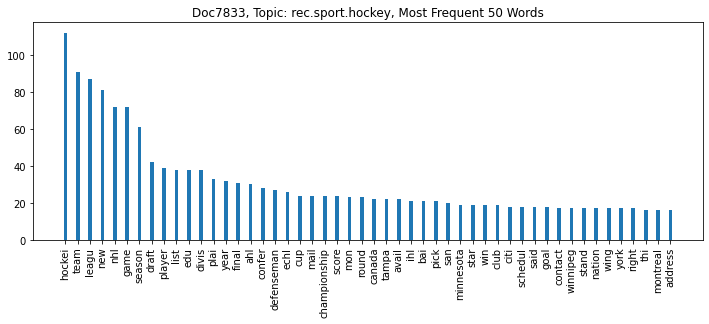

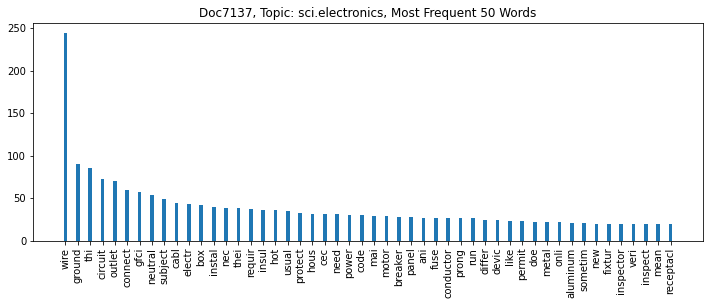

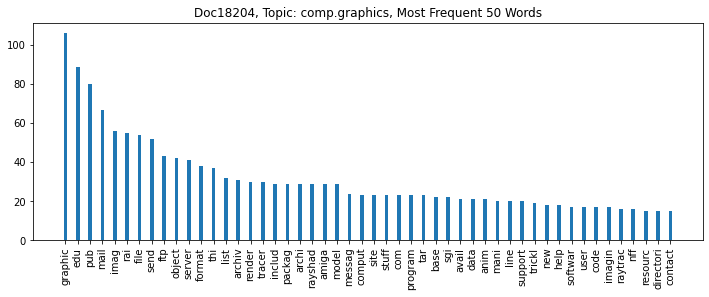

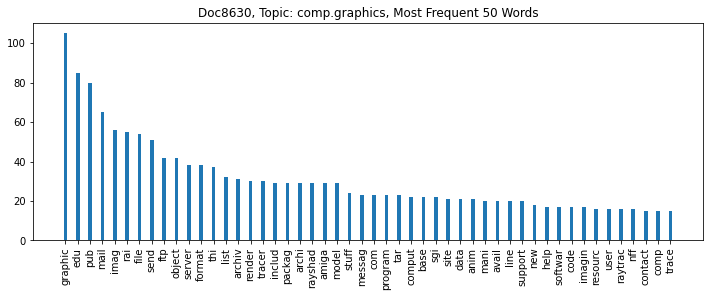

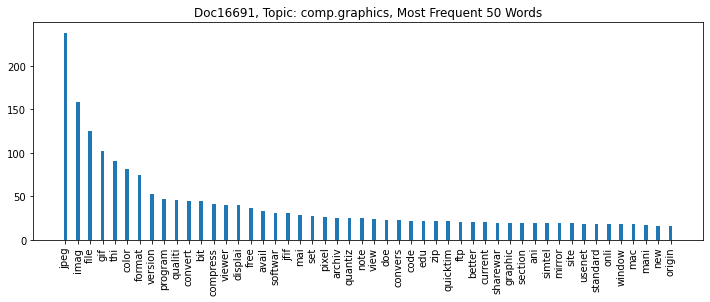

...

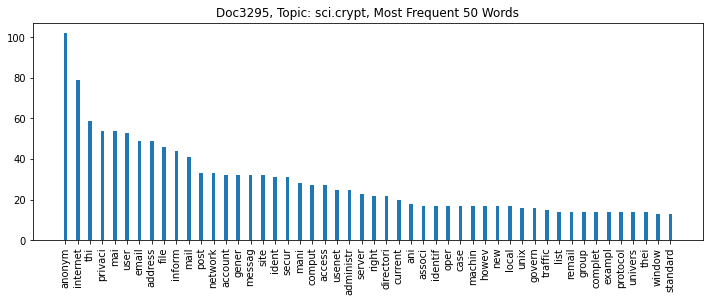

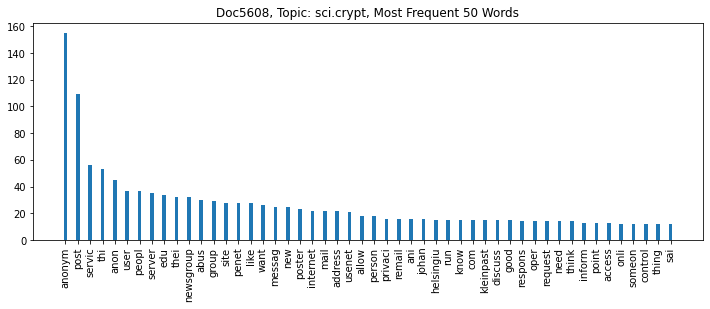

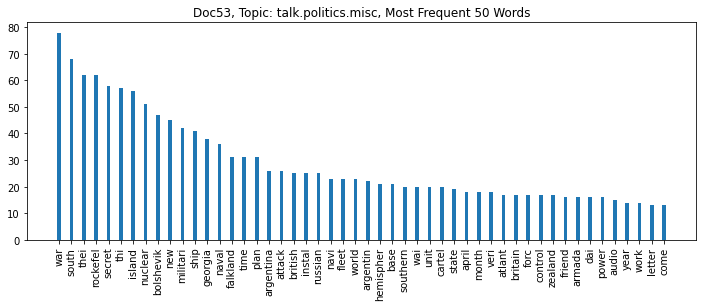

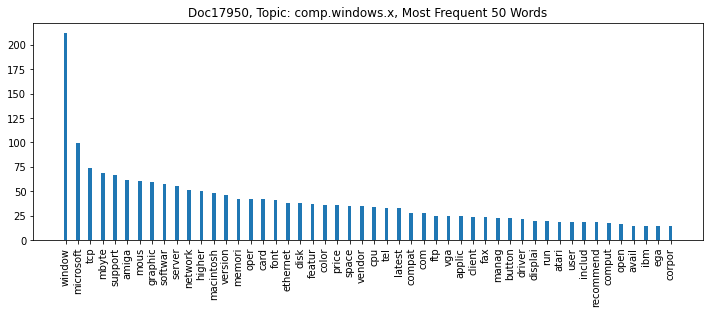

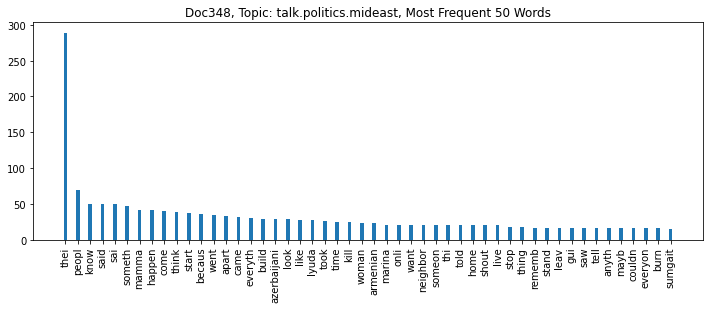

In [7]:
def plot_tf(doc_id, doc):
    _labels, _values = zip(*list(sorted(Counter(doc).items(), key=lambda x: x[1], reverse=True))[:50])

    indexes = np.arange(len(_labels))
    width = 0.3
    plt.figure(figsize=(12,4))
    plt.title('Doc{}, Topic: {}, Most Frequent 50 Words'.format(doc_id, dataset.target_names[labels[doc_id]]))
    plt.bar(indexes, _values, width)
    plt.xticks(indexes, _labels, rotation=90)
    plt.show()


for doc_id, doc in list(sorted(enumerate(corpus1), key=lambda x: len(x[1]), reverse=True))[:20]:
    plot_tf(doc_id, doc)

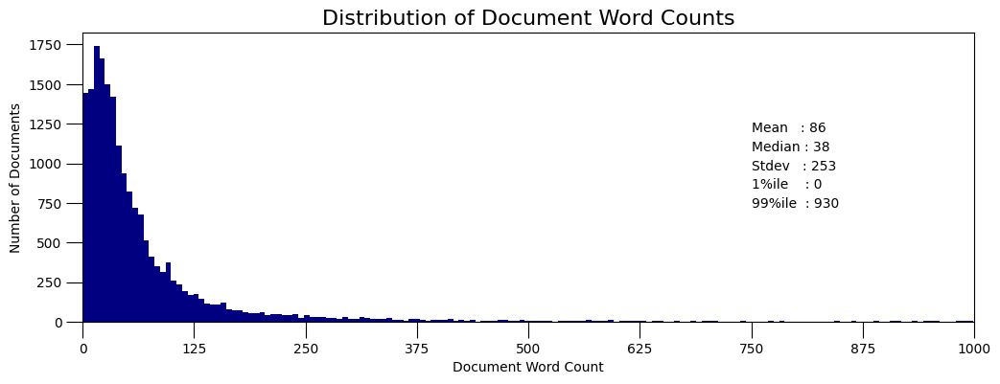

In [8]:
def doc_word_count_stats(corpus):
    doc_lens = [len(doc) for doc in corpus]
    plt.figure(figsize=(12,4), dpi=100)
    plt.hist(doc_lens, bins = 1000, color='navy')
    up=1200
    plt.text(750, up, "Mean   : " + str(round(np.mean(doc_lens))))
    plt.text(750,  up*0.9, "Median : " + str(round(np.median(doc_lens))))
    plt.text(750,  up*0.8, "Stdev   : " + str(round(np.std(doc_lens))))
    plt.text(750,  up*0.7, "1%ile    : " + str(round(np.quantile(doc_lens, q=0.01))))
    plt.text(750,  up*0.6, "99%ile  : " + str(round(np.quantile(doc_lens, q=0.99))))

    plt.gca().set(xlim=(0, 1000), ylabel='Number of Documents', xlabel='Document Word Count')
    plt.tick_params(size=12)
    plt.xticks(np.linspace(0,1000,9))
    plt.title('Distribution of Document Word Counts', fontdict=dict(size=16))
    plt.show()

doc_word_count_stats(corpus1)  


## 1.2. Building the Vocabulary
        2. Build and save your vocabulary (termed as Vocabv1) upon Step 1.  Learn Bag-of-words (BoW) and TF-IDF model for all the documents. (10pts)

#### Step 1- Build vocab

In [9]:
# A more efficient way is to use gensim.corpora
dictionary = corpora.Dictionary(corpus1)
print(dictionary)


# Prune the dict by filtering with document freq (DF)
Vocabv1 = deepcopy(dictionary)
Vocabv1.filter_extremes(no_below=10, no_above=0.5)# no_below and no_above are related to DF
print(Vocabv1)


Vocabv2 = deepcopy(dictionary)
Vocabv2.filter_extremes(no_below=10, no_above=0.5, keep_n=2000)
print(Vocabv2)

'''
# You may also use the freqs to filter dict with TF
low_tf_tokens = [w for w in freqs if freqs[w]<=3]
remove_ids = [dictionary.token2id[w] for w in low_tf_tokens]
print(len(remove_ids))

dictionary.filter_tokens(remove_ids)
dictionary.compactify()  # remove gaps in id sequence after words that were removed
print(dictionary)

# dictionray.cfs collects all the term freqs, similar to freqs
# Let's check if the new dictionary still has token with a tf <= 3
print(len([w for w in dictionary.cfs if dictionary.cfs[w]<=3]))

# Don't forget to save your vocab 
# dictionary.save('your_savepath')
'''



Dictionary(67605 unique tokens: ['castillo', 'cub', 'era', 'good', 'guzman']...)
Dictionary(8972 unique tokens: ['cub', 'era', 'good', 'higher', 'idiot']...)
Dictionary(2000 unique tokens: ['good', 'higher', 'idiot', 'pitch', 'pitcher']...)


"\n# You may also use the freqs to filter dict with TF\nlow_tf_tokens = [w for w in freqs if freqs[w]<=3]\nremove_ids = [dictionary.token2id[w] for w in low_tf_tokens]\nprint(len(remove_ids))\n\ndictionary.filter_tokens(remove_ids)\ndictionary.compactify()  # remove gaps in id sequence after words that were removed\nprint(dictionary)\n\n# dictionray.cfs collects all the term freqs, similar to freqs\n# Let's check if the new dictionary still has token with a tf <= 3\nprint(len([w for w in dictionary.cfs if dictionary.cfs[w]<=3]))\n\n# Don't forget to save your vocab \n# dictionary.save('your_savepath')\n"


#### Step 2- Learn Bag-of-words (BoW)

In [10]:
# You vocab/dictionary finally define your corpus
DataFrame(dictionary.token2id.items(), columns=['word', 'id']).head(20)

,word,id
0,castillo,0
1,cub,1
2,era,2
3,good,3
4,guzman,4
5,harkei,5
6,hibbard,6
7,higher,7
8,idiot,8
9,morgan,9


In [11]:
corpus1_bows = [Vocabv1.doc2bow(doc) for doc in corpus1]
corpus2_bows = [Vocabv2.doc2bow(doc) for doc in corpus1]


print([len(corpus1_bows), len(corpus2_bows)])
print(corpus1_bows[0])
print(corpus2_bows[0])
# Let's see the text difference
print('Preprocess Text: {}'.format(' '.join([w for w in corpus1[0]])))
print('BoW Using Vocabv1: {}'.format(' '.join([Vocabv1[wid] for wid,_ in corpus1_bows[0]])))
print('BoW Using Vocabv2: {}'.format(' '.join([Vocabv2[wid] for wid,_ in corpus2_bows[0]])))


new_corpus1 = [[w for w in doc if w in Vocabv1.token2id] for doc in corpus1]
new_corpus2 = [[w for w in doc if w in Vocabv2.token2id] for doc in corpus1]
print(len(new_corpus1),len(new_corpus2))
print(corpus1[0])
print(new_corpus1[0])
print(new_corpus2[0])

[18846, 18846]
[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1), (8, 1), (9, 1), (10, 1), (11, 1), (12, 1)]
[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1), (8, 1)]
Preprocess Text: morgan guzman era run higher year cub idiot pitch harkei hibbard castillo won good think stud pitcher
BoW Using Vocabv1: cub era good higher idiot morgan pitch pitcher run stud think won year
BoW Using Vocabv2: good higher idiot pitch pitcher run think won year
18846 18846
['morgan', 'guzman', 'era', 'run', 'higher', 'year', 'cub', 'idiot', 'pitch', 'harkei', 'hibbard', 'castillo', 'won', 'good', 'think', 'stud', 'pitcher']
['morgan', 'era', 'run', 'higher', 'year', 'cub', 'idiot', 'pitch', 'won', 'good', 'think', 'stud', 'pitcher']
['run', 'higher', 'year', 'idiot', 'pitch', 'won', 'good', 'think', 'pitcher']


In [12]:
def tf_bow(corpus):
    longest10docs=list(sorted(enumerate(corpus), key=lambda x: len(x[1]), reverse=True))[:10]
    top20w_longest10docs = list(sorted(Counter([word for doc_no, doc in longest10docs for word in doc]).items(), key=lambda x: x[1] , reverse=True))[:20]
    words, freqs = np.array(top20w_longest10docs).T
    _data={'Total':dict(top20w_longest10docs)}
    for doc_no, doc in longest10docs:
        title='Doc{}'.format(doc_no)
        counts=Counter(doc)
        _data[title]=dict((word, counts[word]) for word in words)
    pd.set_option('display.width', 1200)
    df_freq=DataFrame(_data, dtype=int)
    df_freq.sort_values(by='Total', ascending=False, inplace=True)
    df_binary = df_freq.mask(lambda x: x>0,1)
    return {'binary': df_binary, 'freq':df_freq}

bow_stats1=tf_bow(new_corpus1)

In [13]:
bow_stats1['binary'].head(10)

,Total,Doc7833,Doc7137,Doc16691,Doc17833,Doc7977,Doc10047,Doc18204,Doc8630,Doc16895,Doc2149
file,1,1,0,1,1,1,1,1,1,1,1
jpeg,1,0,0,1,1,1,0,1,1,0,0
imag,1,0,0,1,1,1,1,1,1,1,1
thi,1,1,1,1,1,1,1,1,1,1,1
gif,1,0,0,1,1,1,0,1,1,0,0
format,1,1,1,1,1,1,1,1,1,1,0
pub,1,1,0,1,1,1,1,1,1,0,1
edu,1,1,0,1,1,1,1,1,1,0,1
graphic,1,0,0,1,1,1,0,1,1,0,0
color,1,0,0,1,1,1,0,1,1,1,0


In [14]:
bow_stats1['freq'].head(10)

,Total,Doc7833,Doc7137,Doc16691,Doc17833,Doc7977,Doc10047,Doc18204,Doc8630,Doc16895,Doc2149
file,830,9,0,125,125,123,36,54,54,2,302
jpeg,717,0,0,238,236,235,0,4,4,0,0
imag,595,0,0,158,158,157,1,56,56,8,1
thi,531,16,85,91,91,91,30,37,37,24,29
gif,312,0,0,102,102,102,0,3,3,0,0
format,305,1,1,75,74,73,1,38,38,4,0
pub,293,1,0,14,13,14,82,80,80,0,9
edu,289,38,0,22,20,20,10,89,85,0,5
graphic,270,0,0,20,20,19,0,106,105,0,0
color,268,0,0,82,82,84,0,6,6,8,0


#### Step 3- TF-IDF model

In [15]:
pd.set_option('display.width', 1000)
tfidf1 = models.TfidfModel(corpus1_bows)
corpus1_tfidf = tfidf1[corpus1_bows]

def tf_bow(corpus, tfdif, vocab):
    longest10docs=list(sorted(enumerate(corpus), key=lambda x: len(x[1]), reverse=True))[:10]
    top20w_longest10docs = list(sorted(Counter([word for doc_no, doc in longest10docs for word in doc]).items(), key=lambda x: x[1] , reverse=True))[:20]
    words, freqs = np.array(top20w_longest10docs).T
    _data={'Total':dict(top20w_longest10docs)}
    for doc_no, doc in longest10docs:
        title='Doc{}'.format(doc_no)
        weights=dict((vocab[wid], weight) for wid, weight in tfdif[doc_no])
        _data[title]=dict((word, weights[word]) for word in words if word in weights)
    
    df_weighted=DataFrame(_data)
    df_weighted.sort_values(by='Total', ascending=False, inplace=True)
    df_weighted.drop(columns='Total', inplace=True)
    df_weighted.fillna(0, inplace=True)
    
    
    return df_weighted.head(10)

tf_bow(new_corpus1, corpus1_tfidf, Vocabv1)

,Doc7833,Doc7137,Doc16691,Doc17833,Doc7977,Doc10047,Doc18204,Doc8630,Doc16895,Doc2149
file,0.019264,0.000000,0.194175,0.195136,0.192983,0.083935,0.137012,0.139068,0.004238,0.638537
jpeg,0.000000,0.000000,0.733820,0.731254,0.731830,0.000000,0.020144,0.020447,0.000000,0.000000
imag,0.000000,0.000000,0.306551,0.308068,0.307663,0.002912,0.177465,0.180129,0.021173,0.002641
thi,0.009218,0.039211,0.038049,0.038237,0.038430,0.018827,0.025269,0.025648,0.013688,0.016504
gif,0.000000,0.000000,0.260243,0.261531,0.262851,0.000000,0.012502,0.012690,0.000000,0.000000
format,0.002817,0.002256,0.153329,0.152033,0.150736,0.003068,0.126890,0.128794,0.011155,0.000000
pub,0.003418,0.000000,0.034732,0.032410,0.035079,0.305327,0.324164,0.329029,0.000000,0.030390
edu,0.071211,0.000000,0.029920,0.027335,0.027472,0.020412,0.197700,0.191649,0.000000,0.009256
graphic,0.000000,0.000000,0.038351,0.038540,0.036798,0.000000,0.331991,0.333795,0.000000,0.000000
color,0.000000,0.000000,0.157569,0.158349,0.163030,0.000000,0.018832,0.019114,0.020969,0.000000


# 2. Topic Modeling (LDA)
        3. Train a LDA model with Vocabv1.  Visualize topics with at least two different methods, and get the topic distribution (as features) for each document. (15pts)

In [16]:
workers=8

# Set training parameters.
num_topics = 20
chunksize = 10000
passes = 20
iterations = 400
eval_every = None  # Don't evaluate model perplexity, takes too much time.

t0=dt.now()
print(t0)
lda1 = LdaMulticore(
    corpus=corpus1_bows,
    id2word=Vocabv1.id2token,
    chunksize=chunksize,
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every,
    workers=workers
)
print(dt.now()-t0)

2021-03-17 19:12:55.298016
0:02:27.827531


In [17]:
top_topics1 = lda1.top_topics(corpus1_bows)
top_topics1=np.array([np.array([[v,c] for c,v in topic[0]]).T for topic in top_topics1])
top_topics1=top_topics1.reshape((40,20))
df_top_topics1=DataFrame(top_topics1.T, columns=pd.MultiIndex.from_product([list(range(20)),['Word', 'Cont.']], names=['Topic No', 'info']))
df_top_topics1.head(20)

Topic No      0                        1                       2                      3                     4                 ...       15                      16                       17                       18                     19              
info        Word         Cont.       Word         Cont.      Word         Cont.     Word         Cont.    Word         Cont.  ...     Word         Cont.      Word         Cont.       Word         Cont.       Word         Cont.     Word         Cont.
0           thei   0.029434394        god    0.02376706  armenian   0.022224942      kei   0.022881309    game   0.024085699  ...     card   0.017077832      book   0.019780116       bike    0.02401362    univers    0.01889355      max    0.11173554
1            thi    0.01858409        thi    0.02017274      thei   0.011272622      car   0.020473495    team   0.014144667  ...     scsi   0.014756865  homosexu    0.01720227        thi   0.014771176        pit   0.012829773   widget  0.0149087785
2          peopl   0.013186223  christian    0.01360432    muslim   0.008798205      thi   0.017079093    year   0.011947329  ...      thi   0.012105382       thi   0.017153712       ride   0.014176056      space   0.012177106    motif   0.010332693
3          think   0.009388185       jesu    0.01061695   turkish   0.008533391     thei   0.015740845    plai   0.011830266  ...      mac   0.012089641       sex  0.0072854906       thei   0.013111188     period   0.011750617      thi   0.009308754
4           know   0.007942432       thei   0.008857912       thi   0.008162124  encrypt   0.012459633    thei   0.011683821  ...  monitor    0.01180367      thei  0.0068239095        dod   0.008434051        det   0.010635561      edu   0.009178868
5            sai   0.007715158        sai   0.007976297     peopl   0.007456781     chip   0.011315938     thi    0.01140472  ...    drive   0.011750349       gai  0.0061936337  motorcycl   0.007904693        van   0.009674557      giz    0.00912769
6           like   0.007484899     church   0.007230066       war   0.007389038     like    0.00813055  player   0.009744398  ...      mhz   0.010660729    sexual     0.0057177      model   0.006484297       nasa   0.008945672      bhj   0.009103296
7          right   0.006236652      peopl  0.0070322156   russian  0.0056293514  clipper   0.007883475     win  0.0071488763  ...      bit     0.0104621      read   0.005694381       like  0.0059950976        tor    0.00883375   window   0.008241005
8           want  0.0060693915       bibl   0.006633167    govern  0.0053508827    secur  0.0074542942  season  0.0067150723  ...     appl   0.008629858     point  0.0056400793       turn   0.005369946        chi  0.0084452145      set   0.008223011
9            ani    0.00595222       word  0.0063890843    turkei   0.005031886    phone  0.0064762915  hockei  0.0058325646  ...    video  0.0084435055       men  0.0051091383        ani  0.0052968035        min   0.007583389   applic  0.0075109876
10          time  0.0058957357     believ   0.006279043      turk    0.00472197      bit   0.006235783    time  0.0057116835  ...     disk  0.0076809316     group  0.0047164056     helmet  0.0051528392  professor   0.007387752      mit  0.0069654393
11           gun  0.0056360965     christ  0.0062230076   armenia  0.0044307536    engin   0.005501693     hit  0.0055935844  ...    speed    0.00751045      time  0.0046839104       know   0.005140081        rai  0.0071441215      sun   0.006570661
12          said   0.005326922        sin  0.0054977266    nation   0.004366004      ani   0.005254116   score   0.005464346  ...  control   0.007392124      like    0.00465376      think   0.005103716        que  0.0069545633   includ   0.005853841
13         thing  0.0053008567        doe   0.005234748     greek  0.0043249493      new  0.0052248533   think   0.005444926  ...      ram  0.0073017995    inform   0.004542306       onli   0.005097512        nyi  0.0069122836      lib   0.005797956


In [18]:
def format_topics_sentences(ldamodel, bow, corpus):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for doc_no, topic_probs in enumerate(ldamodel[bow]):       
        topic_no, prop_topic = max(topic_probs, key=lambda x: (x[1]))
        topic = ldamodel.show_topic(topic_no)
        topic_keywords = ", ".join([word for word, prop in topic])
        sent_topics_df = sent_topics_df.append(pd.Series([topic_no, dataset.target_names[labels[doc_no]], '{}%'.format(100*round(prop_topic,4)), topic_keywords]), ignore_index=True)

    # Add original text to the end of the output
    contents = pd.Series(corpus)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    
    sent_topics_df = sent_topics_df.reset_index()
    sent_topics_df.columns = ['Doc No', 'Dominant Topic #', 'Original Topic Name', 'Contribution', 'Keywords', 'Text']
    sent_topics_df.set_index('Doc No')
    return(sent_topics_df)

lda1_topics_text = format_topics_sentences(lda1, corpus1_bows, new_corpus1)

In [19]:
pd.set_option('display.max_colwidth', 70)
lda1_topics_text.head(10)

,Doc No,Dominant Topic #,Original Topic Name,Contribution,Keywords,Text
0,0,4.0,rec.sport.baseball,93.2099997997284%,"game, team, year, plai, thei, thi, player, win, season, hockei","[morgan, era, run, higher, year, cub, idiot, pitch, won, good, thi..."
1,1,6.0,comp.sys.mac.hardware,45.660001039505005%,"thi, ani, thank, know, anyon, drive, problem, work, doe, like","[got, centri, yesterdai, took, week, place, order, dealer, rutger,..."
2,2,13.0,sci.crypt,52.20999717712402%,"file, thi, window, program, edu, run, ftp, user, avail, graphic","[archiv, cryptographi, faq, modifi, faq, sci, crypt, refer, thi, t..."
3,3,2.0,comp.sys.mac.hardware,37.25000023841858%,"card, scsi, thi, mac, monitor, drive, mhz, bit, appl, video","[best, knowledg, aren, ani, problem, quadra, blind, transfer, trou..."
4,4,18.0,alt.atheism,96.48000001907349%,"book, homosexu, thi, sex, thei, gai, sexual, read, point, men","[think, domest, chang, behavior, larg, degre, domest, anim, exhibi..."
5,5,6.0,comp.sys.mac.hardware,84.0399980545044%,"thi, ani, thank, know, anyon, drive, problem, work, doe, like","[help, adb, tablet, want, connect, quadra, unfortun, onli, adb, po..."
6,6,6.0,comp.windows.x,45.35999894142151%,"thi, ani, thank, know, anyon, drive, problem, work, doe, like","[hello, world, want, write, applic, code, like, thi, work, need, u..."
7,7,13.0,comp.windows.x,45.3900009393692%,"file, thi, window, program, edu, run, ftp, user, avail, graphic","[emac, want, custom, keyboard, better, set, stuff, emac, keymap, d..."
8,8,6.0,sci.med,75.08000135421753%,"thi, ani, thank, know, anyon, drive, problem, work, doe, like","[doe, anyon, thi, newsgroup, happen, know, isol, know, idea, look,..."
9,9,3.0,sci.electronics,30.52999973297119%,"thi, power, wire, ground, thei, like, batteri, water, circuit, light","[look, help, choos, packag, high, speed, silicon, adc, mhz, curren..."


In [20]:

print(lda1_topics_text.shape)
pprint(list(lda1[corpus1_bows])[:5]) #topic distributions for each doc
pprint(list(lda1.show_topics(num_topics=20, num_words=50, formatted=False))) #word weights in topics

(18846, 6)
[[(4, 0.9320947)],
 [(2, 0.3843461), (3, 0.15019543), (6, 0.45669004)],
 [(5, 0.09696403),
  (7, 0.0664831),
  (10, 0.09931907),
  (13, 0.5221362),
  (15, 0.15796544),
  (18, 0.04764925)],
 [(0, 0.10095728),
  (2, 0.3725014),
  (3, 0.07419715),
  (6, 0.1347254),
  (9, 0.2707937),
  (16, 0.03960587)],
 [(18, 0.9648051)]]
[(0,
  [('bike', 0.02401362),
   ('thi', 0.014771176),
   ('ride', 0.014176056),
   ('thei', 0.013111188),
   ('dod', 0.008434051),
   ('motorcycl', 0.007904693),
   ('model', 0.006484297),
   ('like', 0.0059950976),
   ('turn', 0.005369946),
   ('ani', 0.0052968035),
   ('helmet', 0.0051528392),
   ('know', 0.005140081),
   ('think', 0.005103716),
   ('onli', 0.005097512),
   ('time', 0.004988575),
   ('rider', 0.0049553406),
   ('dog', 0.004799929),
   ('wai', 0.0047554076),
   ('look', 0.00441539),
   ('theori', 0.0042909496),
   ('right', 0.0042746193),
   ('befor', 0.004250727),
   ('thing', 0.0042268042),
   ('loop', 0.004129292),
   ('wave', 0.00405339

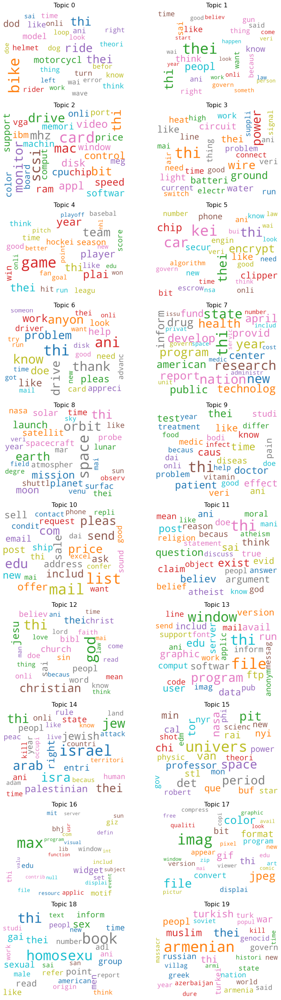

In [21]:
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=get_stop_words('en'),
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=30,
                  colormap='tab10')

def display_wc(lda):
    topics = lda.show_topics(num_topics=20, num_words=30, formatted=False)
    fig, axes = plt.subplots(10, 2, figsize=(12,36), sharex=True, sharey=True)

    for i, ax in enumerate(axes.flatten()):
        fig.add_subplot(ax)
        topic_words = dict(topics[i][1])
        cloud.generate_from_frequencies(topic_words, max_font_size=300)
        plt.gca().imshow(cloud)
        plt.gca().set_title('Topic {}'.format(topics[i][0]), fontdict=dict(size=16))
        plt.gca().axis('off')

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.axis('off')
    plt.margins(x=0, y=0)
    plt.tight_layout()
    plt.show()

display_wc(lda1)

In [22]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(topic_model=lda1, corpus=corpus1_bows, dictionary=Vocabv1)
vis


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.142460 -0.048432       1        1  16.023155
13    -0.182413 -0.040215       2        1  10.321814
12     0.147859 -0.025078       3        1   8.281090
4      0.044917  0.087785       4        1   6.209652
6     -0.076506 -0.137884       5        1   5.907856
7      0.015401  0.107072       6        1   5.422874
19     0.154044  0.080603       7        1   5.332858
11     0.109077 -0.079377       8        1   5.077349
5      0.027697 -0.098319       9        1   4.789512
3     -0.016113 -0.067271      10        1   3.853004
2     -0.148865 -0.109785      11        1   3.841770
9      0.073085 -0.047561      12        1   3.577625
10    -0.094808  0.043959      13        1   3.290440
8      0.000195  0.059564      14        1   3.190666
18     0.073588  0.016523      15        1   3.036276
16    -0.218213  0.002551      16        1   2.808583
14     0.151339 -0.016197      17        1   2.719351
17    -0.164886 -0.063019      18        1   2.692955
0      0.041102 -0.048633      19        1   1.875779
15    -0.078963  0.383716      20        1   1.747393, topic_info=        Term         Freq        Total Category  logprob  loglift
823      max  4624.000000  4624.000000  Default  30.0000  30.0000
224     file  3912.000000  3912.000000  Default  29.0000  29.0000
2008    imag  2430.000000  2430.000000  Default  28.0000  28.0000
1623     god  3574.000000  3574.000000  Default  27.0000  27.0000
750     game  2365.000000  2365.000000  Default  26.0000  26.0000
...      ...          ...          ...      ...      ...      ...
1050  physic   121.727136   606.224603  Topic20  -5.3533   2.4416
765     shot   123.174498   635.876570  Topic20  -5.3414   2.4056
61     power   137.492784  2079.874268  Topic20  -5.2315   1.3306
325      new   140.784009  5092.035892  Topic20  -5.2078   0.4588
400   scienc   113.481245   807.320589  Topic20  -5.4234   2.0850

[1515 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
1589      1  0.191507  absolut
1589      2  0.047403  absolut
1589      3  0.058779  absolut
1589      4  0.034130  absolut
1589      5  0.007584  absolut
...     ...       ...      ...
489       2  0.352453      zip
489       4  0.003325      zip
489      10  0.003325      zip
489      16  0.006650      zip
489      18  0.625105      zip

[8344 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 14, 13, 5, 7, 8, 20, 12, 6, 4, 3, 10, 11, 9, 19, 17, 15, 18, 1, 16])

# 3. Vector Representation of Documents (Word2Vec  and  Doc2Vec)

    - 4. Train  Word2Vec  and  Doc2Vec  models  upon Vocabv1.   Visualize  your  learned  word  and  document embedding space (e.g., using t-SNE1). Collect Doc2Vec representation of each document. (15pts)

## 3.1. Word2Vec

### 3.1.1 Word2Vec Training

In [23]:
class Iterator():
    def __init__(self, corpus):
        self.corpus=corpus
    
    def __iter__(self):
        for doc in self.corpus:
            yield doc

sentences1= Iterator(new_corpus1)
wv1 = gensim.models.Word2Vec(sentences=sentences1, min_count=10)


### 3.1.2. Word2Vec Visualization with TSNE

In [24]:
def reduce_dimensions_wv(model, vocab, top=2000):
    num_dimensions = 2  # final num dimensions (2D, 3D, etc)

    # extract the words & their vectors, as numpy arrays
    vectors = np.asarray(model.wv.vectors)
    _labels = np.asarray(model.wv.index2word)  # fixed-width numpy strings
    
    top_n = deepcopy(vocab)
    top_n.filter_extremes(keep_n=top)
    _mask=np.array(list(map(lambda x: x in top_n.token2id, _labels)))
    vectors = vectors[_mask]
    _labels = _labels[_mask]
    
    # reduce using t-SNE
    tsne = mTSNE(n_components=num_dimensions,random_state=0, n_jobs=8)
    vectors = tsne.fit_transform(vectors)

    x_vals = np.array([v[0] for v in vectors])
    y_vals = np.array([v[1] for v in vectors])
    return x_vals, y_vals, _labels

def plot_with_plotly(x_vals, y_vals, labels, plot_in_notebook=True):
    trace = go.Scatter(x=x_vals, y=y_vals, mode='text', text=labels)
    data = [trace]

    if plot_in_notebook:
        init_notebook_mode(connected=True)
        iplot(data, filename='word-embedding-plot')
    else:
        plot(data, filename='word-embedding-plot.html')


def plot_with_matplotlib(x_vals, y_vals, labels):
    random.seed(0)

    plt.figure(figsize=(12, 12))
    plt.scatter(x_vals, y_vals)

    #
    # Label randomly subsampled 25 data points
    #
    indices = list(range(len(labels)))
    selected_indices = random.sample(indices, 25)
    for i in selected_indices:
        plt.annotate(labels[i], (x_vals[i], y_vals[i]))

try:
    get_ipython()
except Exception:
    plot_function = plot_with_matplotlib
else:
    plot_function = plot_with_plotly

x_vals_v1, y_vals_v1, labels_v1 = reduce_dimensions_wv(wv1, vocab=Vocabv1, top=100)
plot_function(x_vals_v1, y_vals_v1, labels_v1)

In [25]:
DataFrame(wv1.wv.most_similar(positive=['internet'], topn=10), columns=['Word', 'Similarity']).head(10)

,Word,Similarity
0,penio,0.852737
1,org,0.821192
2,compuserv,0.818966
3,gov,0.815189
4,bitnet,0.812996
5,andrew,0.804900
6,rfc,0.802893
7,gopher,0.801449
8,nist,0.800049
9,cpsr,0.791903


## 3.2. Doc2Vec

### 3.2.1. Doc2Vec Training

In [25]:
def preprocess_corpus_dv(corpus, docs_only=False):
        for doc_no, doc in enumerate(corpus):
            if docs_only:
                yield doc
            else:
                # For training data, add tags
                yield gensim.models.doc2vec.TaggedDocument(doc, [doc_no])

dv_corpus1 = list(preprocess_corpus_dv(new_corpus1))

dv1 = gensim.models.doc2vec.Doc2Vec(vector_size=50, min_count=2, epochs=40)
dv1.build_vocab(dv_corpus1)

In [26]:
t0=dt.now()
print(t0)
dv1.train(dv_corpus1, total_examples=dv1.corpus_count, epochs=dv1.epochs)
print(dt.now()-t0)

2021-03-16 18:55:58.905167
0:01:11.466178


In [27]:
def map_vectors(dv_model, corpus):
    df= DataFrame(np.array([list(range(len(corpus))),[dataset.target_names[label] for label in labels], corpus]).T, columns=['Doc No','Topic', 'Text'])
    df['Doc2Vec Vector']=[tuple(vectors) for vectors in dv_model.docvecs.vectors_docs]
    return df

dv1_df = map_vectors(dv1, new_corpus1)
dv1_df.head(10)

,Doc No,Topic,Text,Doc2Vec Vector
0,0,rec.sport.baseball,"[morgan, era, run, higher, year, cub, idiot, pitch, won, good, thi...","(-0.37764242, -0.19261673, -0.30329114, -0.5322323, -0.34273717, -..."
1,1,comp.sys.mac.hardware,"[got, centri, yesterdai, took, week, place, order, dealer, rutger,...","(0.50321114, 1.6586049, 1.7920295, 0.18763684, -0.42359626, 2.0087..."
2,2,sci.crypt,"[archiv, cryptographi, faq, modifi, faq, sci, crypt, refer, thi, t...","(4.736908, -2.026548, 3.5554771, 1.7136694, -3.2946508, -5.110499,..."
3,3,comp.sys.mac.hardware,"[best, knowledg, aren, ani, problem, quadra, blind, transfer, trou...","(-0.7150432, 0.5150563, 0.7445549, 0.093865365, -3.106314, 0.01440..."
4,4,alt.atheism,"[think, domest, chang, behavior, larg, degre, domest, anim, exhibi...","(0.35069498, 0.11682004, -0.6920737, -0.39940605, 0.34101582, 0.52..."
5,5,comp.sys.mac.hardware,"[help, adb, tablet, want, connect, quadra, unfortun, onli, adb, po...","(0.29586253, 0.02820264, 1.0157531, 0.74903697, -0.70272386, 0.497..."
6,6,comp.windows.x,"[hello, world, want, write, applic, code, like, thi, work, need, u...","(-0.56683743, 0.5470498, 0.24934278, 0.9291189, -1.1828471, 0.4040..."
7,7,comp.windows.x,"[emac, want, custom, keyboard, better, set, stuff, emac, keymap, d...","(-0.4485206, 0.04414244, 0.72090936, 1.8032774, -1.6430176, 1.1737..."
8,8,sci.med,"[doe, anyon, thi, newsgroup, happen, know, isol, know, idea, look,...","(-0.18872055, 0.7606147, 0.3316945, 0.4384776, -0.09574274, 0.2724..."
9,9,sci.electronics,"[look, help, choos, packag, high, speed, silicon, adc, mhz, curren...","(0.6570382, 1.9036138, 0.15163991, -0.7794801, -2.3930318, 2.11941..."


In [28]:
def reduce_dimensions_dv(dv_df):
    num_dimensions = 2  # final num dimensions (2D, 3D, etc)
    # reduce using t-SNE
    tsne = mTSNE(n_components=num_dimensions, random_state=0, n_jobs=workers)
    x,y=tsne.fit_transform(np.asarray([np.array(vectors) for vectors in dv_df['Doc2Vec Vector']])).T
    dv_df.insert(2, 'x', x)
    dv_df.insert(3, 'y', y)

t0=dt.now()
print(t0)
reduce_dimensions_dv(dv1_df)
print('exec time: {}'.format(dt.now()-t0))

2021-03-16 18:57:10.597215
exec time: 0:02:57.001395


In [29]:
dv1_df.head(10)

,Doc No,Topic,x,y,Text,Doc2Vec Vector
0,0,rec.sport.baseball,-2.373145,16.385387,"[morgan, era, run, higher, year, cub, idiot, pitch, won, good, thi...","(-0.37764242, -0.19261673, -0.30329114, -0.5322323, -0.34273717, -..."
1,1,comp.sys.mac.hardware,-9.971673,-8.436857,"[got, centri, yesterdai, took, week, place, order, dealer, rutger,...","(0.50321114, 1.6586049, 1.7920295, 0.18763684, -0.42359626, 2.0087..."
2,2,sci.crypt,3.288440,16.706194,"[archiv, cryptographi, faq, modifi, faq, sci, crypt, refer, thi, t...","(4.736908, -2.026548, 3.5554771, 1.7136694, -3.2946508, -5.110499,..."
3,3,comp.sys.mac.hardware,-6.975462,-16.339500,"[best, knowledg, aren, ani, problem, quadra, blind, transfer, trou...","(-0.7150432, 0.5150563, 0.7445549, 0.093865365, -3.106314, 0.01440..."
4,4,alt.atheism,9.905558,0.205921,"[think, domest, chang, behavior, larg, degre, domest, anim, exhibi...","(0.35069498, 0.11682004, -0.6920737, -0.39940605, 0.34101582, 0.52..."
5,5,comp.sys.mac.hardware,-2.587365,-10.490883,"[help, adb, tablet, want, connect, quadra, unfortun, onli, adb, po...","(0.29586253, 0.02820264, 1.0157531, 0.74903697, -0.70272386, 0.497..."
6,6,comp.windows.x,5.733317,-17.458076,"[hello, world, want, write, applic, code, like, thi, work, need, u...","(-0.56683743, 0.5470498, 0.24934278, 0.9291189, -1.1828471, 0.4040..."
7,7,comp.windows.x,5.330811,-18.615588,"[emac, want, custom, keyboard, better, set, stuff, emac, keymap, d...","(-0.4485206, 0.04414244, 0.72090936, 1.8032774, -1.6430176, 1.1737..."
8,8,sci.med,2.993723,3.045458,"[doe, anyon, thi, newsgroup, happen, know, isol, know, idea, look,...","(-0.18872055, 0.7606147, 0.3316945, 0.4384776, -0.09574274, 0.2724..."
9,9,sci.electronics,-18.214149,2.529443,"[look, help, choos, packag, high, speed, silicon, adc, mhz, curren...","(0.6570382, 1.9036138, 0.15163991, -0.7794801, -2.3930318, 2.11941..."


In [30]:
import bokeh.plotting as bp
from bokeh.models import HoverTool, BoxSelectTool
from bokeh.models import ColumnDataSource
from bokeh.plotting import figure, show, output_notebook, reset_output
from bokeh.palettes import Category20c as col
import bokeh.models as bmo


def visualize_dv_doc_embeddings_2d(df_dv):
    output_notebook()
    plot_d2v = bp.figure(plot_width = 1200, 
                         plot_height = 900, 
                           title = "T-SNE applied to Doc2vec document embeddings",
                           tools = "pan, wheel_zoom, box_zoom, reset, hover",
                           x_axis_type = None, y_axis_type = None, min_border = 1)

    # colormap = np.array(["#6d8dca", "#d07d3c"])
    source = ColumnDataSource(data = dict(x = df_dv["x"], 
                                          y = df_dv["y"],
                                          color = df_dv["Doc No"].apply(lambda x: col[20][labels[x]]),
                                          text = df_dv["Text"],
                                          doc_no = df_dv["Doc No"],
                                          topic = df_dv["Topic"]))

    plot_d2v.scatter(x = "x", 
                       y = "y", 
                       color="color",
                       legend = "topic",
                       source = source,
                       alpha = 0.7)
    hover = plot_d2v.select(dict(type = HoverTool))
    hover.tooltips = {"Doc no": "@doc_no", 
                      "Text": "@text", 
                      "Topic":"@topic"}

    show(plot_d2v)

visualize_dv_doc_embeddings_2d(dv1_df)


Loading BokehJS ...

# 4.  Clustering (K-Means)

    5.  Conduct document clustering by K-means with four different doc.  representations that you obtained from Step 2-4
        Including 
        i) BoW; 
        ii) TF-IDF; 
        iii) Topics distribution; and 
        iv) Doc2Vec.  

        Obtain another vocabulary, denoted as Vocabv2, by taking the top 2K words from Vocabv1. Learn the above fourdoc.  representations (i.e., i-iv) with Vocabv2 and get the K-means clustering result by NMI for each doc. representation method.  To sum up, you should have 
        (1) a table with the size of 2×4 NMI valuesand 
        (2) a visualization (similar to HW2) result of the best clustering result indicated by NMI. (25 pts)

## 4.1. Get nd Vector Respresentations of BoW, TFIDF, Topics Distribution and Doc2Vec Analysis
- TSNE will use them to reduce dimensionality for KMeans Clustering

In [31]:
def get_vectors(vocab, corpus, lda, dv_model):
    t0=dt.now()
    print(t0)
    cv = CountVectorizer(vocabulary=vocab.token2id)
    bow_matrix=cv.fit_transform([".".join(doc) for doc in corpus]) #.todense()
    #pprint(bow_matrix)
    tt = TfidfTransformer()
    tfidf_matrix=tt.fit_transform(bow_matrix) #.todense()

    topics_matrix= np.zeros((tfidf_matrix.shape[0], 20)) #20 is the topic amount
    for doc_no, doc in enumerate(corpus):
        for topic, cont in lda[vocab.doc2bow(doc)]:
            topics_matrix[doc_no][topic]=cont
    
    dv_vectors= dv_model.docvecs.vectors_docs
    print('vectors extraction time: {}'.format(dt.now()-t0))
    return {'bow': bow_matrix, 'tfidf': tfidf_matrix, 'topic_dist': topics_matrix, 'doc2vec': dv_vectors}
    
v1_vectors= get_vectors(Vocabv1, new_corpus1, lda1, dv1)

2021-03-16 19:00:09.812939
vectors extraction time: 0:00:20.285551


In [32]:
from sklearn.decomposition import TruncatedSVD

def reduce_dims(data, tsne=None):
    t0=dt.now()
    if not data.shape[1]<=50:
        print('TrSVD start: {}, data shape: {}'.format(t0, data.shape))
        data = TruncatedSVD(n_components=50).fit_transform(data)
    t1=dt.now()
    print('TSNE start: {}, data shape: {},  TrSVD total: {}'.format(t1, data.shape, t1-t0))
    tsne = tsne if tsne else  mTSNE(random_state=0, n_jobs=workers)
    data = tsne.fit_transform(data)
    t2=dt.now()
    print('TSNE total: {}, reduction total: {}'.format(t2-t1, t2-t0))
    #pprint(data)
    return data

In [33]:
v1_2d_vecs= dict((name,reduce_dims(data)) for name, data in v1_vectors.items())
pprint(v1_2d_vecs)

TrSVD start: 2021-03-16 19:00:30.137467, data shape: (18846, 8972)
TSNE start: 2021-03-16 19:00:31.569774, data shape: (18846, 50),  TrSVD total: 0:00:01.432307
TSNE total: 0:03:09.522777, reduction total: 0:03:10.955084
TrSVD start: 2021-03-16 19:03:41.094550, data shape: (18846, 8972)
TSNE start: 2021-03-16 19:03:42.481164, data shape: (18846, 50),  TrSVD total: 0:00:01.386614
TSNE total: 0:03:13.200619, reduction total: 0:03:14.587233
TSNE start: 2021-03-16 19:06:55.682783, data shape: (18846, 20),  TrSVD total: 0:00:00
TSNE total: 0:03:18.693804, reduction total: 0:03:18.693804
TSNE start: 2021-03-16 19:10:14.377592, data shape: (18846, 50),  TrSVD total: 0:00:00
TSNE total: 0:02:59.869027, reduction total: 0:02:59.869027
{'bow': array([[-14.06342227, -23.99218671],
       [ 21.9234603 ,  -1.52283554],
       [ 34.21840072,  21.29325454],
       ...,
       [-15.82858696,   2.74903719],
       [  4.98726536,  25.59073167],
       [ -1.64428906, -16.96374674]]),
 'doc2vec': array([[

## 4.2.  K-Means Cluster Model

In [34]:
def KMeans_nmi(data, iteration=200):
    t1=dt.now()
    print('KMeans start: {}'.format(t1))
    km = KMeans(n_clusters=20, n_init=iteration)
    km.fit(data)
    t2=dt.now()
    print('Kmeans exec time: {}'.format(t2-t1))
        
    return {'2d':data, 'nmi':nmi_score(labels, km.labels_), 'labels_':km.labels_}

In [35]:
pprint(KMeans_nmi(v1_2d_vecs["bow"]))

KMeans start: 2021-03-16 19:13:14.289594
Kmeans exec time: 0:00:32.842044
{'2d': array([[-14.06342227, -23.99218671],
       [ 21.9234603 ,  -1.52283554],
       [ 34.21840072,  21.29325454],
       ...,
       [-15.82858696,   2.74903719],
       [  4.98726536,  25.59073167],
       [ -1.64428906, -16.96374674]]),
 'labels_': array([ 4,  1, 13, ...,  0,  9,  7]),
 'nmi': 0.13073687609919504}


## 4.3. Run KMeans and find mean NMI for each doc representation method

In [36]:
kmeans_results_v1=dict(map(lambda x: (x[0], KMeans_nmi(x[1])), v1_2d_vecs.items()))                       

KMeans start: 2021-03-16 19:13:47.174614
Kmeans exec time: 0:00:32.771314
KMeans start: 2021-03-16 19:14:19.958920
Kmeans exec time: 0:00:35.757153
KMeans start: 2021-03-16 19:14:55.728065
Kmeans exec time: 0:00:35.903463
KMeans start: 2021-03-16 19:15:31.644521
Kmeans exec time: 0:00:38.502290


In [37]:
df_nmis = DataFrame(dict(map(lambda x: (x[0], x[1]['nmi']), kmeans_results_v1.items())), index=['Vocabv1'])
df_nmis.head(10)

,bow,tfidf,topic_dist,doc2vec
Vocabv1,0.132761,0.32806,0.325039,0.355687


## 4.4. Obtain Vocabv2 as most frequent 2000 words in Vocabv1 and find 4 NMI to compare Vocabv1 

In [38]:
t0=dt.now()
print(t0)
#Vocabv2 = deepcopy(Vocabv1)
#Vocabv2.filter_extremes(no_below=10, no_above=0.5, keep_n=2000)

#corpus2_bows = [Vocabv2.doc2bow(doc) for doc in corpus1]
#new_corpus2 = [[w for w in doc if w in Vocabv2.token2id] for doc in corpus1]
Vocabv2.id2token= dict((idx,token) for token,idx in Vocabv2.token2id.items())

t1=dt.now()
print(t1-t0)
lda2 = LdaMulticore(
    corpus=corpus2_bows,
    id2word=Vocabv2.id2token,
    chunksize=2000,
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every,
    workers=workers
)
t2=dt.now()
print("LDA exec time: {}".format(t2-t1))
dv_corpus2 = list(preprocess_corpus_dv(new_corpus2))
dv2 = gensim.models.doc2vec.Doc2Vec(vector_size=50, min_count=2, epochs=40)
dv2.build_vocab(dv_corpus2)
t3=dt.now()
print("D2V exec time: {}, total:{}".format(t3-t2, t3-t0))

2021-03-16 19:16:10.218770
0:00:00.001999
LDA exec time: 0:02:45.779591
D2V exec time: 0:00:05.646113, total:0:02:51.427703


In [39]:
pyLDAvis.enable_notebook()
vis2 = pyLDAvis.gensim.prepare(topic_model=lda2, corpus=corpus2_bows, dictionary=Vocabv2)
vis2

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2     -0.108054 -0.072939       1        1  10.827453
3     -0.061102  0.019986       2        1   9.385650
6     -0.061741 -0.082345       3        1   8.013287
1      0.193684 -0.031319       4        1   7.957399
17    -0.127715  0.061390       5        1   6.842523
15     0.237365  0.007171       6        1   5.204896
0     -0.020269 -0.109005       7        1   4.990438
18    -0.133038 -0.055352       8        1   4.615100
8      0.201871  0.060190       9        1   4.611267
13     0.066922  0.025328      10        1   4.605168
14    -0.157377 -0.116954      11        1   4.529636
9      0.009722 -0.069036      12        1   4.308509
4      0.109384  0.046924      13        1   4.142986
5      0.012367 -0.017470      14        1   3.816939
10    -0.047420  0.158369      15        1   3.743952
11     0.154757 -0.051656      16        1   3.686015
12     0.013425  0.044808      17        1   3.170525
7     -0.054460 -0.083624      18        1   2.649477
16    -0.102637 -0.081940      19        1   2.263803
19    -0.125684  0.347476      20        1   0.634975, topic_info=        Term          Freq         Total Category  logprob  loglift
552      max   3034.000000   3034.000000  Default  30.0000  30.0000
1048     god   3751.000000   3751.000000  Default  29.0000  29.0000
427   window   3227.000000   3227.000000  Default  28.0000  28.0000
60      thei  15331.000000  15331.000000  Default  27.0000  27.0000
506     game   2716.000000   2716.000000  Default  26.0000  26.0000
...      ...           ...           ...      ...      ...      ...
181   includ     29.448707   2880.342571  Topic20  -5.5304   0.4763
1087    care     25.186078   1017.624502  Topic20  -5.6868   1.3604
488    right     27.453137   3763.700363  Topic20  -5.6006   0.1387
161   follow     25.874991   2274.507569  Topic20  -5.6598   0.5831
372      els     23.673497   1262.569633  Topic20  -5.7487   1.0828

[1095 rows x 6 columns], token_table=      Topic      Freq  Term
term                       
928       1  0.094704  abil
928       2  0.091835  abil
928       3  0.172190  abil
928       4  0.034438  abil
928       5  0.017219  abil
...     ...       ...   ...
314       4  0.885133   zip
314       6  0.082723   zip
314      15  0.013787   zip
314      16  0.013787   zip
314      20  0.002757   zip

[8079 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 4, 7, 2, 18, 16, 1, 19, 9, 14, 15, 10, 5, 6, 11, 12, 13, 8, 17, 20])

In [40]:
v2_vectors= get_vectors(Vocabv2, new_corpus2, lda2, dv2)

2021-03-16 19:19:20.010416
vectors extraction time: 0:00:17.878893


In [41]:
v2_2d_vecs= dict((name,reduce_dims(data)) for name, data in v2_vectors.items())
pprint(v2_2d_vecs)

TrSVD start: 2021-03-16 19:19:37.901192, data shape: (18846, 2000)
TSNE start: 2021-03-16 19:19:38.763244, data shape: (18846, 50),  TrSVD total: 0:00:00.862052
TSNE total: 0:03:05.300914, reduction total: 0:03:06.162966
TrSVD start: 2021-03-16 19:22:44.064158, data shape: (18846, 2000)
TSNE start: 2021-03-16 19:22:44.917951, data shape: (18846, 50),  TrSVD total: 0:00:00.853793
TSNE total: 0:03:03.547428, reduction total: 0:03:04.401221
TSNE start: 2021-03-16 19:25:48.465379, data shape: (18846, 20),  TrSVD total: 0:00:00
TSNE total: 0:03:14.784378, reduction total: 0:03:14.784378
TSNE start: 2021-03-16 19:29:03.249757, data shape: (18846, 50),  TrSVD total: 0:00:00
TSNE total: 0:03:55.203059, reduction total: 0:03:55.203059
{'bow': array([[-16.25909111, -20.92671718],
       [ 20.22589257, -11.38510892],
       [ 33.72252047,  20.42787223],
       ...,
       [-16.42736744,   3.30234961],
       [  6.92900965,  27.0862382 ],
       [ -0.90010347, -18.14037609]]),
 'doc2vec': array([[

In [42]:
kmeans_results_v2=dict(map(lambda x: (x[0], KMeans_nmi(x[1])), v2_vectors.items()))
kmeans_results= {'Vocabv1': kmeans_results_v1, 'Vocabv2':kmeans_results_v2}
                       
df2_nmis = DataFrame(dict(map(lambda x: (x[0], x[1]['nmi']), kmeans_results_v2.items())), index=['Vocabv2'])
df2_nmis.head(10)

KMeans start: 2021-03-16 19:32:58.487306
Kmeans exec time: 0:02:43.513561
KMeans start: 2021-03-16 19:35:42.010862
Kmeans exec time: 0:19:30.646427
KMeans start: 2021-03-16 19:55:12.670281
Kmeans exec time: 0:00:37.820436
KMeans start: 2021-03-16 19:55:50.501807
Kmeans exec time: 0:03:21.503969


,bow,tfidf,topic_dist,doc2vec
Vocabv2,0.017934,0.288602,0.304569,0.00299


## 4.5. Find the best clustering result indicated by NMI 

In [43]:
df_nmi=df_nmis.append(df2_nmis)

df_nmi.insert(4, 'best_method', df_nmi.idxmax(axis="columns"))
df_nmi.insert(5, 'best_nmi', df_nmi.max(axis="columns"))
df_nmi.head(10)

,bow,tfidf,topic_dist,doc2vec,best_method,best_nmi
Vocabv1,0.132761,0.328060,0.325039,0.355687,doc2vec,0.355687
Vocabv2,0.017934,0.288602,0.304569,0.002990,topic_dist,0.304569


## 4.6. Visualise the best clustering result

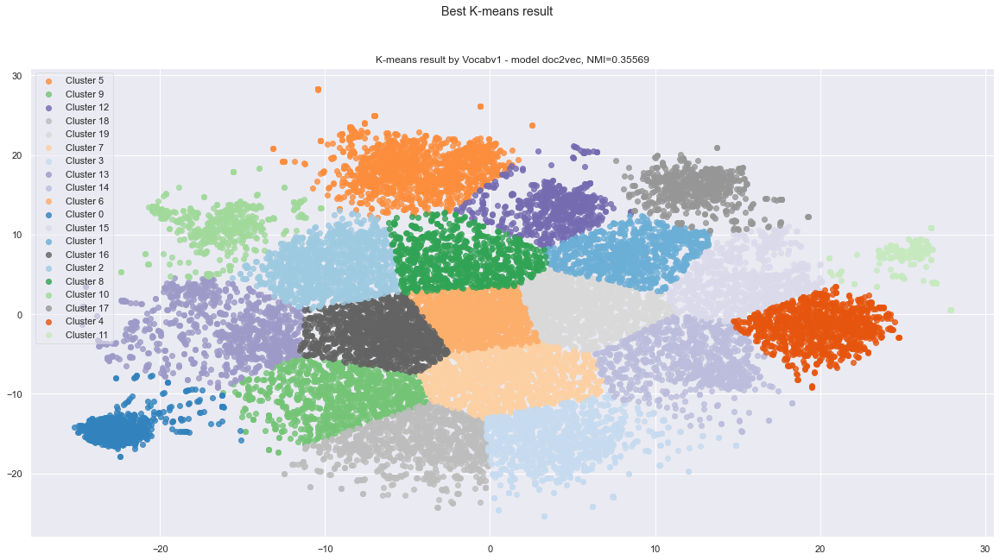

In [44]:
sns.set_theme()

best_vocab=df_nmi['best_nmi'].idxmax()
best_model = kmeans_results[best_vocab][df_nmi.at[best_vocab,'best_method']]

fig, ax = plt.subplots(1, 1, figsize=(20,10))
fig.suptitle('Best K-means result')

ax.set_title('K-means result by {} - model {}, NMI={:.5f}'.format(best_vocab, 
                                                                  df_nmi.at[best_vocab,'best_method'],
                                                                  best_model['nmi']))

cluster_data=defaultdict(list)
for doc_no, cluster_no in enumerate(best_model['labels_']):
    cluster_data[cluster_no].append(doc_no)

coords = np.array(best_model['2d'])

for cluster_no, docs in cluster_data.items():
    x,y= coords[docs].T
    ax.scatter(x, y, color=col[20][cluster_no], alpha=.8, label='Cluster {}'.format(cluster_no))

ax.legend(fancybox=True, framealpha=0.5)



# 5. Analysis
Do experiment analysis from one of the following aspects: 1) Impact of different preprocessing ways(e.g., compare the K-means or LDA visualizations between different vocabs); 2) Impact of differenttopic numbers; and 3) Impact of different clustering methods on the clustering result.

## 5.1 Different Pre-processing Methods

In [45]:
dictionary3 = corpora.Dictionary(corpus1)
Vocab3 = deepcopy(dictionary3)
Vocab4 = deepcopy(dictionary3)
Vocab3.filter_extremes(no_below=15, no_above=0.5)
Vocab4.filter_extremes(no_below=5, no_above=0.5)
print(Vocab3)
print(Vocab4)

Dictionary(6899 unique tokens: ['cub', 'era', 'good', 'higher', 'idiot']...)
Dictionary(14527 unique tokens: ['cub', 'era', 'good', 'guzman', 'higher']...)


In [46]:
corpus3_bows = [Vocab3.doc2bow(doc) for doc in corpus1]
corpus4_bows = [Vocab4.doc2bow(doc) for doc in corpus1]
new_corpus3 = [[w for w in doc if w in Vocab3.token2id] for doc in corpus1]
new_corpus4 = [[w for w in doc if w in Vocab4.token2id] for doc in corpus1]

In [47]:
tfidf3 = models.TfidfModel(corpus3_bows)
corpus3_tfidf=tfidf3[corpus3_bows]
tf_bow(new_corpus3, corpus3_tfidf, Vocab3)

,Doc7833,Doc7137,Doc16691,Doc17833,Doc7977,Doc10047,Doc18204,Doc8630,Doc2149,Doc16895
file,0.019580,0.000000,0.194411,0.195375,0.193217,0.086025,0.138439,0.140500,0.641026,0.004301
jpeg,0.000000,0.000000,0.734712,0.732151,0.732719,0.000000,0.020354,0.020657,0.000000,0.000000
imag,0.000000,0.000000,0.306924,0.308446,0.308037,0.002985,0.179315,0.181984,0.002651,0.021489
thi,0.009369,0.039668,0.038095,0.038284,0.038477,0.019296,0.025532,0.025912,0.016569,0.013893
gif,0.000000,0.000000,0.260559,0.261852,0.263170,0.000000,0.012632,0.012820,0.000000,0.000000
format,0.002863,0.002282,0.153515,0.152220,0.150919,0.003145,0.128212,0.130120,0.000000,0.011321
pub,0.003474,0.000000,0.034774,0.032450,0.035122,0.312931,0.327543,0.332418,0.030509,0.000000
edu,0.072378,0.000000,0.029956,0.027368,0.027506,0.020921,0.199761,0.193622,0.009292,0.000000
graphic,0.000000,0.000000,0.038397,0.038588,0.036843,0.000000,0.335452,0.337233,0.000000,0.000000
color,0.000000,0.000000,0.157761,0.158543,0.163228,0.000000,0.019028,0.019311,0.000000,0.021283


In [48]:
tfidf4 = models.TfidfModel(corpus4_bows)
corpus4_tfidf=tfidf4[corpus4_bows]
tf_bow(new_corpus4, corpus4_tfidf, Vocab4)

,Doc7833,Doc7137,Doc18204,Doc16691,Doc17833,Doc7977,Doc8630,Doc10047,Doc16895,Doc2149
file,0.019075,0.000000,0.130341,0.191535,0.192464,0.190314,0.132162,0.082674,0.004167,0.632583
jpeg,0.000000,0.000000,0.019164,0.723842,0.721241,0.721710,0.019431,0.000000,0.000000,0.000000
imag,0.000000,0.000000,0.168825,0.302383,0.303849,0.303408,0.171183,0.002868,0.020816,0.002616
thi,0.009128,0.038241,0.024038,0.037532,0.037714,0.037899,0.024374,0.018544,0.013458,0.016350
gif,0.000000,0.000000,0.011893,0.256704,0.257949,0.259216,0.012059,0.000000,0.000000,0.000000
format,0.002789,0.002200,0.120712,0.151244,0.149951,0.148651,0.122398,0.003022,0.010967,0.000000
pub,0.003385,0.000000,0.308381,0.034259,0.031966,0.034594,0.312690,0.300742,0.000000,0.030107
edu,0.070511,0.000000,0.188075,0.029513,0.026960,0.027093,0.182131,0.020106,0.000000,0.009169
graphic,0.000000,0.000000,0.315828,0.037829,0.038013,0.036289,0.317219,0.000000,0.000000,0.000000
color,0.000000,0.000000,0.017915,0.155427,0.156181,0.160775,0.018165,0.000000,0.020617,0.000000


In [49]:
lda3 = LdaMulticore(
    corpus=corpus3_bows,
    id2word=Vocab3.id2token,
    chunksize=chunksize,
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every,
    workers=workers
)

In [50]:
lda4 = LdaMulticore(
    corpus=corpus4_bows,
    id2word=Vocab4.id2token,
    chunksize=chunksize,
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every,
    workers=workers
)

In [51]:
pyLDAvis.enable_notebook()
vis3 = pyLDAvis.gensim.prepare(topic_model=lda3, corpus=corpus3_bows, dictionary=Vocab3)
vis3

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
7      0.066085  0.000572       1        1  9.851961
9      0.086849  0.115938       2        1  8.234323
13     0.109558  0.078356       3        1  7.897992
18     0.112949  0.095675       4        1  7.865901
10    -0.170781 -0.034431       5        1  6.006932
1     -0.217983  0.005651       6        1  5.923231
11     0.157276 -0.040030       7        1  5.055880
15    -0.185184  0.011523       8        1  5.054074
2     -0.104695 -0.063695       9        1  4.830777
4     -0.049979  0.098583      10        1  4.766409
19     0.129631  0.105879      11        1  4.442245
3      0.034800 -0.041487      12        1  4.421713
12    -0.069033 -0.077602      13        1  4.095926
8      0.026981 -0.046333      14        1  3.905638
5      0.011944  0.112626      15        1  3.827589
17    -0.196544 -0.008121      16        1  3.636566
14     0.117748 -0.186185      17        1  3.399076
6      0.158447 -0.243759      18        1  2.786894
16    -0.085084 -0.038975      19        1  2.063191
0      0.067017  0.155814      20        1  1.933681, topic_info=      Term          Freq         Total Category  logprob  loglift
771    max   4563.000000   4563.000000  Default  30.0000  30.0000
1527   god   3455.000000   3455.000000  Default  29.0000  29.0000
73    thei  15258.000000  15258.000000  Default  28.0000  28.0000
709   game   2370.000000   2370.000000  Default  27.0000  27.0000
1893  imag   2418.000000   2418.000000  Default  26.0000  26.0000
...    ...           ...           ...      ...      ...      ...
825   free    122.865427   1296.907377  Topic20  -5.4204   1.5891
448   word    127.082133   1764.325776  Topic20  -5.3867   1.3151
54    onli    135.615691   5630.990943  Topic20  -5.3217   0.2195
601    doe    122.735780   4487.215701  Topic20  -5.4215   0.3468
73    thei    118.866799  15258.635660  Topic20  -5.4535  -0.9092

[1448 rows x 6 columns], token_table=      Topic      Freq Term
term                      
4405      4  0.020006  abc
4405      6  0.030009  abc
4405      7  0.020006  abc
4405     16  0.030009  abc
4405     17  0.890280  abc
...     ...       ...  ...
456       9  0.006683  zip
456      13  0.013367  zip
456      14  0.010025  zip
456      16  0.558069  zip
456      19  0.003342  zip

[8737 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[8, 10, 14, 19, 11, 2, 12, 16, 3, 5, 20, 4, 13, 9, 6, 18, 15, 7, 17, 1])

In [52]:
pyLDAvis.enable_notebook()
vis4 = pyLDAvis.gensim.prepare(topic_model=lda4, corpus=corpus4_bows, dictionary=Vocab4)
vis4

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
14    -0.022767 -0.115864       1        1  14.745063
18    -0.013523 -0.113935       2        1  10.577311
15     0.080813  0.022764       3        1   6.902221
19     0.193756  0.144542       4        1   6.813297
17     0.169332  0.059077       5        1   5.821588
16     0.109493 -0.035093       6        1   5.645536
13    -0.130053  0.018679       7        1   5.331382
9      0.155483  0.051788       8        1   5.264985
0     -0.054220 -0.154303       9        1   4.937120
4      0.079435  0.053493      10        1   4.608934
3     -0.114065 -0.150710      11        1   4.602773
2      0.156840  0.042319      12        1   4.240329
6     -0.015562 -0.113632      13        1   4.174594
10    -0.016574 -0.056250      14        1   3.868088
7      0.020608 -0.065475      15        1   3.716242
8      0.011746 -0.055470      16        1   2.483133
12    -0.108076 -0.088733      17        1   2.053699
5     -0.184720  0.098213      18        1   1.796559
1     -0.235779  0.239037      19        1   1.292595
11    -0.082167  0.219551      20        1   1.124552, topic_info=        Term          Freq         Total Category  logprob  loglift
904      max   4058.000000   4058.000000  Default  30.0000  30.0000
679   window   3525.000000   3525.000000  Default  29.0000  29.0000
1809     god   3485.000000   3485.000000  Default  28.0000  28.0000
804     game   2300.000000   2300.000000  Default  27.0000  27.0000
77      thei  15279.000000  15279.000000  Default  26.0000  26.0000
...      ...           ...           ...      ...      ...      ...
302     issu    106.890827   1479.538169  Topic20  -5.0776   1.8601
372   origin     94.683337   1367.403235  Topic20  -5.1989   1.8177
1764   print     85.251416    672.571464  Topic20  -5.3038   2.4223
72      ship     78.273564    625.778674  Topic20  -5.3892   2.4090
758     forc     80.435119   1118.108587  Topic20  -5.3619   1.8558

[1548 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
7294      1  0.125677    aaron
7294      7  0.083784    aaron
7294     18  0.013964    aaron
7294     19  0.768024    aaron
5583      4  0.043820      abc
...     ...       ...      ...
7710     10  0.046492   zenith
6704      1  0.010496  zionist
6704      9  0.829211  zionist
6704     11  0.010496  zionist
6704     17  0.136452  zionist

[8047 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[15, 19, 16, 20, 18, 17, 14, 10, 1, 5, 4, 3, 7, 11, 8, 9, 13, 6, 2, 12])

## 5.2 Different Topic Numbers

In [53]:
num_topics = 5
lda5 = LdaMulticore(
    corpus=corpus1_bows,
    id2word=Vocabv1.id2token,
    chunksize=chunksize,
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every,
    workers=workers
)

In [54]:
num_topics = 30
lda6 = LdaMulticore(
    corpus=corpus1_bows,
    id2word=Vocabv1.id2token,
    chunksize=chunksize,
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every,
    workers=workers
)

In [55]:
pyLDAvis.enable_notebook()
vis5 = pyLDAvis.gensim.prepare(topic_model=lda5, corpus=corpus1_bows, dictionary=Vocabv1)
vis5

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.059937  0.128691       1        1  33.124532
0     -0.013544 -0.163442       2        1  23.608220
4     -0.036462  0.071762       3        1  20.135598
3      0.157589 -0.041557       4        1  12.212268
2     -0.167519  0.004546       5        1  10.919381, topic_info=       Term          Freq         Total Category  logprob  loglift
823     max   4708.000000   4708.000000  Default  30.0000  30.0000
224    file   4031.000000   4031.000000  Default  29.0000  29.0000
750    game   2285.000000   2285.000000  Default  28.0000  28.0000
74     thei  15166.000000  15166.000000  Default  27.0000  27.0000
629  window   3500.000000   3500.000000  Default  26.0000  26.0000
..      ...           ...           ...      ...      ...      ...
48     know    643.305024   6427.835222   Topic5  -5.5208  -0.0871
553   pleas    464.684357   2511.849178   Topic5  -5.8461   0.5272
557   thank    461.212212   2394.835282   Topic5  -5.8536   0.5674
495    best    439.367857   1504.052574   Topic5  -5.9021   0.9840
644    look    446.395187   3836.360655   Topic5  -5.8863   0.0636

[432 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
5460      4  0.992360        adl
99        1  0.001743  algorithm
99        2  0.986347  algorithm
99        3  0.005228  algorithm
99        4  0.005228  algorithm
...     ...       ...        ...
12        3  0.232408       year
12        4  0.188919       year
12        5  0.271221       year
4436      4  0.987462      yeast
834       4  0.979760        zei

[1128 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 1, 5, 4, 3])

In [56]:
pyLDAvis.enable_notebook()
vis6 = pyLDAvis.gensim.prepare(topic_model=lda6, corpus=corpus1_bows, dictionary=Vocabv1)
vis6

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
22     0.089319  0.103024       1        1  11.253749
16     0.110721  0.064223       2        1   7.431065
10    -0.174392  0.034488       3        1   5.811335
28     0.140436  0.071966       4        1   5.773219
1      0.045649 -0.011706       5        1   5.710802
7      0.075192  0.109413       6        1   5.311734
12    -0.159240  0.087659       7        1   4.246894
18    -0.172627  0.016615       8        1   4.004671
3     -0.212119 -0.076852       9        1   3.904761
25    -0.022099  0.031707      10        1   3.898934
19     0.090900  0.076112      11        1   3.835609
2      0.045256  0.049665      12        1   3.773687
9     -0.003441  0.153174      13        1   3.709901
0     -0.084807  0.137936      14        1   3.194534
21    -0.008148  0.051797      15        1   3.166056
20    -0.100760  0.059654      16        1   2.946074
26    -0.139164  0.061734      17        1   2.571917
11    -0.071632 -0.095311      18        1   2.323021
24     0.196379 -0.027394      19        1   2.319447
23     0.181711 -0.049324      20        1   2.184710
6     -0.098413 -0.086123      21        1   2.006833
5      0.132559 -0.025653      22        1   1.763949
4     -0.102030  0.014779      23        1   1.660333
27    -0.022284 -0.249576      24        1   1.366672
15     0.012421 -0.044931      25        1   1.173018
8      0.132894 -0.042516      26        1   1.139719
13    -0.067304 -0.337129      27        1   1.021596
17     0.188403 -0.142182      28        1   0.860134
14    -0.000879  0.039923      29        1   0.832198
29    -0.002500  0.024827      30        1   0.803426, topic_info=          Term         Freq        Total Category  logprob  loglift
823        max  4290.000000  4290.000000  Default  30.0000  30.0000
1623       god  3520.000000  3520.000000  Default  29.0000  29.0000
629     window  3343.000000  3343.000000  Default  28.0000  28.0000
224       file  3965.000000  3965.000000  Default  27.0000  27.0000
2821  armenian  1785.000000  1785.000000  Default  26.0000  26.0000
...        ...          ...          ...      ...      ...      ...
1456   germani    36.307350   293.782252  Topic30  -5.7860   2.7332
917     receiv    40.576885   975.116450  Topic30  -5.6749   1.6447
520        pai    38.663719   782.198848  Topic30  -5.7232   1.8168
370     public    39.802979  1557.240836  Topic30  -5.6941   1.1573
632      anyon    39.660174  2777.385988  Topic30  -5.6977   0.5751

[2158 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
8668     12  0.916959  abdomin
8058     10  0.113611   aboard
8058     21  0.852084   aboard
1589      1  0.595158  absolut
1589      2  0.048256  absolut
...     ...       ...      ...
489      11  0.013460      zip
489      23  0.053840      zip
489      24  0.003365      zip
489      28  0.006730      zip
8937     23  0.942302    zyxel

[14090 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[23, 17, 11, 29, 2, 8, 13, 19, 4, 26, 20, 3, 10, 1, 22, 21, 27, 12, 25, 24, 7, 6, 5, 28, 16, 9, 14, 18, 15, 30])

## 5.3 Different Clustering Methods

In [62]:
from sklearn.cluster import SpectralClustering, AgglomerativeClustering

def Agglo_nmi(data, iteration = 200):
    t1=dt.now()
    print('AgglomerativeClustering start time: {}'.format(t1))
    ac = AgglomerativeClustering(n_clusters = 20) 
    ac.fit(data)
    t2=dt.now()
    print('AgglomerativeClustering exec time: {}'.format(t2-t1))
    
    return {'2d':data, 'nmi':nmi_score(labels,ac.labels_), 'labels_':ac.labels_}

In [66]:
def Spect_nmi(data, iteration = 200):
    t1=dt.now()
    print('SpectralClustering start time: {}'.format(t1))
    sc = SpectralClustering(n_clusters = 20, n_init=1)
    sc.fit(data)
    t2=dt.now()
    print('SpectralClustering exec time: {}'.format(t2-t1))
    
    return {'2d':data, 'nmi':nmi_score(labels,sc.labels_), 'labels_':sc.labels_}

In [63]:
agglo_results_v1=dict(map(lambda x: (x[0], Agglo_nmi(x[1])), v1_2d_vecs.items()))                       

AgglomerativeClustering start time: 2021-03-16 21:28:13.999907
AgglomerativeClustering exec time: 0:00:15.338094
AgglomerativeClustering start time: 2021-03-16 21:28:29.394969
AgglomerativeClustering exec time: 0:00:16.904939
AgglomerativeClustering start time: 2021-03-16 21:28:46.310901
AgglomerativeClustering exec time: 0:00:13.848377
AgglomerativeClustering start time: 2021-03-16 21:29:00.169285
AgglomerativeClustering exec time: 0:00:12.687690


In [65]:
df3_nmis = DataFrame(dict(map(lambda x: (x[0], x[1]['nmi']), agglo_results_v1.items())), index=['Agglomerative Clustering: Vocabv1'])
df3_nmis.head(10)

,bow,tfidf,topic_dist,doc2vec
Agglomerative Clustering: Vocabv1,0.138922,0.326452,0.348085,0.350882


In [67]:
spect_results_v1=dict(map(lambda x: (x[0], Spect_nmi(x[1])), v1_2d_vecs.items()))

SpectralClustering start time: 2021-03-16 21:42:33.350708
SpectralClustering exec time: 0:06:06.746918
SpectralClustering start time: 2021-03-16 21:48:40.569354
SpectralClustering exec time: 0:05:57.654502
SpectralClustering start time: 2021-03-16 21:54:38.655623
SpectralClustering exec time: 0:26:22.093867
SpectralClustering start time: 2021-03-16 22:21:01.225778
SpectralClustering exec time: 0:03:33.914495


In [69]:
df4_nmis = DataFrame(dict(map(lambda x: (x[0], x[1]['nmi']), spect_results_v1.items())), index=['Spectral Clustering: Vocabv1'])
df4_nmis.head(10)

,bow,tfidf,topic_dist,doc2vec
Spectral Clustering: Vocabv1,0.150235,0.362614,0.333103,0.356268


In [73]:
df_nmi=df_nmis.append(df2_nmis).append(df3_nmis).append(df4_nmis)

df_nmi.head(10)

,bow,tfidf,topic_dist,doc2vec
Vocabv1,0.132761,0.328060,0.325039,0.355687
Vocabv2,0.017934,0.288602,0.304569,0.002990
Agglomerative Clustering: Vocabv1,0.138922,0.326452,0.348085,0.350882
Spectral Clustering: Vocabv1,0.150235,0.362614,0.333103,0.356268


# 6. Supervised Learning

              precision    recall  f1-score   support

           0       0.20      0.25      0.22       334
           1       0.33      0.38      0.36       413
           2       0.35      0.42      0.38       405
           3       0.24      0.33      0.28       368
           4       0.22      0.26      0.24       397
           5       0.41      0.39      0.40       388
           6       0.25      0.28      0.27       393
           7       0.28      0.35      0.31       405
           8       0.19      0.25      0.22       362
           9       0.22      0.22      0.22       377
          10       0.54      0.52      0.53       393
          11       0.43      0.45      0.44       384
          12       0.14      0.11      0.12       401
          13       0.28      0.25      0.26       406
          14       0.49      0.36      0.42       403
          15       0.47      0.46      0.46       404
          16       0.27      0.26      0.27       351
          17       0.53    

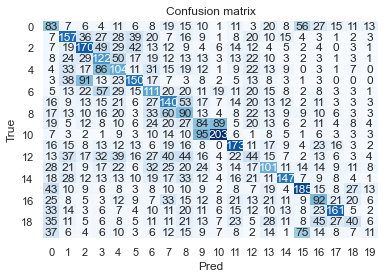

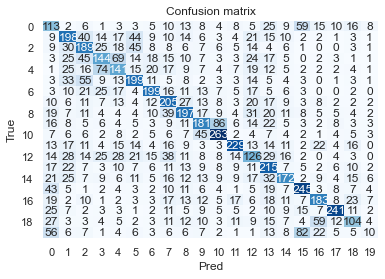

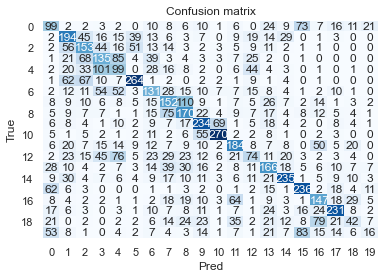

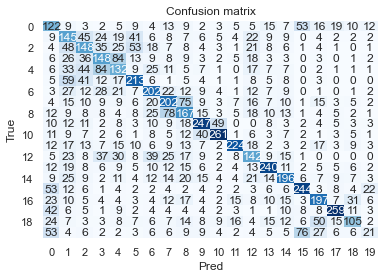

In [103]:
from sklearn.model_selection import train_test_split
from sklearn import neighbors
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay, plot_confusion_matrix
import colored
from colored import stylize

def test_classifier(X, y, clf, test_size=0.4, y_names=None, confusion=True):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size)
    
    clf.fit(X_train, y_train)
    y_predicted = clf.predict(X_test)

    if not confusion:
        title = colored.fg('magenta') + colored.attr('bold')
        print (stylize('Classification Report:', title))
        print (classification_report(y_test, y_predicted, target_names=y_names))
    else:
        title = colored.fg('magenta') + colored.attr('bold')
        #print (stylize('Confusion Matrix:', title))
        cm = confusion_matrix(y_test, y_predicted)
        fig, ax = plt.subplots()
        sns.heatmap(cm, annot=True, fmt='d', ax=ax, cmap=plt.cm.Blues, cbar=False)
        ax.set(xlabel="Pred", ylabel="True", title="Confusion matrix")
        plt.yticks(rotation=0)
        print (classification_report(y_test, y_predicted, target_names=y_names))

        

clf = neighbors.KNeighborsClassifier(10)

test_classifier(v1_2d_vecs["bow"], labels, clf)
test_classifier(v1_2d_vecs["tfidf"], labels, clf)
test_classifier(v1_2d_vecs["topic_dist"], labels, clf)
test_classifier(v1_2d_vecs["doc2vec"], labels, clf)